## Organ differences by Milo - myeloid

# Let's find the differential distribution of MACs across organs across time
- Let's take the Macrophage score and count number of cells enriched with this module (>0 Z-score)

#### This follows from: 
- LR across cross organ integration
- SCVI integegration of just MAC lineage
- SCVI DEGs of Pre-AGM YS macs vs all macs post AGM
- Top markers used to create a functional score


#### Relabel YS macrophages acording to Pan-fetal annotations
- YS macs should be iron recyling and LYVE1 high

In [1]:
import sys
import subprocess

#import pkg_resources
#required = {'harmonypy','sklearn','scanpy','pandas', 'numpy', 'bbknn', 'scipy', 'matplotlib', 'seaborn' ,'scipy'}
#installed = {pkg.key for pkg in pkg_resources.working_set}
#missing = required - installed
#if missing:
#    print("Installing missing packages:" )
#    print(missing)
#    python = sys.executable
#    subprocess.check_call([python, '-m', 'pip', 'install', *missing], stdout=subprocess.DEVNULL)

%matplotlib inline
from collections import Counter
from collections import defaultdict
import scanpy as sc
import pandas as pd
import pickle as pkl
import numpy as np
from bbknn import bbknn
import scipy
import matplotlib.pyplot as plt
import re
import glob
import os
import sys
from numpy import cov
import scipy.cluster.hierarchy as spc
import seaborn as sns; sns.set(color_codes=True)
from sklearn.linear_model import LogisticRegression
import sklearn
from pathlib import Path

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=300, color_map='viridis')
plt.rcParams['figure.figsize'] = [8, 8]

/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# variables module

models = {
'pan_fetal':'/nfs/team205/ig7/resources/scripts_dont_modify/logit_regression_models/adifa_lr/celltypist_model.Pan_Fetal_Human.pkl',
'pan_fetal_wget':'https://celltypist.cog.sanger.ac.uk/models/Pan_Fetal_Suo/v2/Pan_Fetal_Human.pkl',
'adata_scvi':'/nfs/team205/ig7/mount/gdrive/g_cloud/projects/amniontic_fluid/scvi_low_dim_model.sav',
'adata_ldvae':'/nfs/team205/ig7/mount/gdrive/g_cloud/projects/amniontic_fluid/ldvae_low_dim_model.sav',
'adata_harmony':'/nfs/team205/ig7/work_backups/backup_210306/projects/amiotic_fluid/train_low_dim_model/organ_low_dim_model.sav',
'test_low_dim_ipsc_ys':'/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_030522_notebooks/Integrating_HM_data_030522/YS_logit/lr_model.sav',
'YS_X':'/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/YS_X_model_080922.sav'
}
adatas_dict = {
'amnion':'/nfs/team205/ig7/work_backups/backup_210306/projects/amiotic_fluid/data/from_max/v1_a1_amnion.h5ad',
'adata_scvi':'/nfs/team205/ig7/mount/gdrive/g_cloud/projects/amniontic_fluid/scvi_model_landscape_low_dim.h5ad',
'adata_ldvae':'/nfs/team205/ig7/mount/gdrive/g_cloud/projects/amniontic_fluid/ldvae_model_landscape_low_dim.h5ad',
'adata_harmony':'/nfs/team205/ig7/mount/gdrive/g_cloud/projects/amniontic_fluid/data/model_landscape_low_dim.h5ad',
'fliv_wget_test':'https://app.cellatlas.io/fetal-liver/dataset/1/download',
'test_low_dim_ys':'/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_030522_notebooks/Integrating_HM_data_030522/YS_logit/YS_vt_HM_YS_LR_normalised_umap.h5ad',
'matched_EL':'//lustre/scratch117/cellgen/team298/SharedFolders/YS_proj/Datasets/A4_V8_Eliver_raw_updated_metadata_20220523.h5ad',
'YS_citeseq':'/lustre/scratch117/cellgen/team298/SharedFolders/YS_proj/Datasets/ys_citeseq_rna_raw_20220701.h5ad',
'gonads':'/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/Gonads/A1_V1_gonads_LR_panf_ys.h5ad',
'YS_X':'/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/Submission_2_data/A2_V9_scvi_YS_integrated/A2_V9_scvi_V8_model_selected_raw_qc_scr_umap.h5ad',
'scvi_V8_all_myeloid':'/nfs/team205/ig7/work_backups/backup_210306/projects/YS/rebuttal_figs_010922/01_Fetal_YS_MAC_across_organs/SCVi_mac_integration_degs/macs_panf_ys_brain_eliv/A1_V8_scvi_YS_macs_updated_panf_gonads_brain_build_donor_organ_corrected_120922.h5ad',
}

# Variable assignment
adata_key = 'scvi_V8_all_myeloid'#'fliv_wget_test' # key for dictionary entry containing local or web path to adata/s can be either url or local 
data_merge = False # read and merge multiple adata (useful, but keep false for now)
model_key = 'pan_fetal_wget'#'test_low_dim_ipsc_ys'# key for model of choice can be either url or local 
train_x_partition = 'X' # what partition was the data trained on? To keep simple, for now only accepts 'X'
dyn_std = 1.96 # Dynamic cutoffs using std of the mean for each celltype probability, gives a column notifying user of uncertain labels 1 == 68Ci, 1.96 = 95CI
freq_redist = 'cell_labels_lvl2'#'cell.labels'#'False#'cell.labels'#False # False or key of column in anndata object which contains labels/clusters // not currently implemented

# Partial scaling ver
- scale across 10 mini bulks/every 100,000 cells
- sequential learning for scaling
- sequential application of scaling

In [3]:
def load_models(model_dict,model_run):
    if (Path(model_dict[model_run])).is_file():
        # Load data (deserialize)
        model = pkl.load(open(model_dict[model_run], "rb"))
        return model
    elif 'https' in model_dict[model_run]:
        print('Loading model from web source')
        r_get = requests.get(model_dict[model_run])
        fpath = './model_temp.sav'
        open(fpath , 'wb').write(r_get.content)
        model = pkl.load(open(fpath, "rb"))
        return model

def load_adatas(adatas_dict,data_merge, data_key_use):
    if data_merge == True:
        # Read
        gene_intersect = {} # unused here
        adatas = {}
        for dataset in adatas_dict.keys():
            if 'https' in adatas_dict[dataset]:
                print('Loading anndata from web source')
                adatas[dataset] = sc.read('./temp_adata.h5ad',backup_url=adatas_dict[dataset])
            adatas[dataset] = sc.read(data[dataset])
            adatas[dataset].var_names_make_unique()
            adatas[dataset].obs['dataset_merge'] = dataset
            adatas[dataset].obs['dataset_merge'] = dataset
            gene_intersect[dataset] = list(adatas[dataset].var.index)
        adata = list(adatas.values())[0].concatenate(list(adatas.values())[1:],join='inner')
        return adatas, adata
    elif data_merge == False:
        if 'https' in adatas_dict[data_key_use]:
            print('Loading anndata from web source')
            adata = sc.read('./temp_adata.h5ad',backup_url=adatas_dict[data_key_use])
        else: 
            adata = sc.read(adatas_dict[data_key_use])
        del adata.uns
        del adata.obsp
        return adata

In [4]:
adata =  load_adatas(adatas_dict, data_merge, adata_key)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:58)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:08:08)


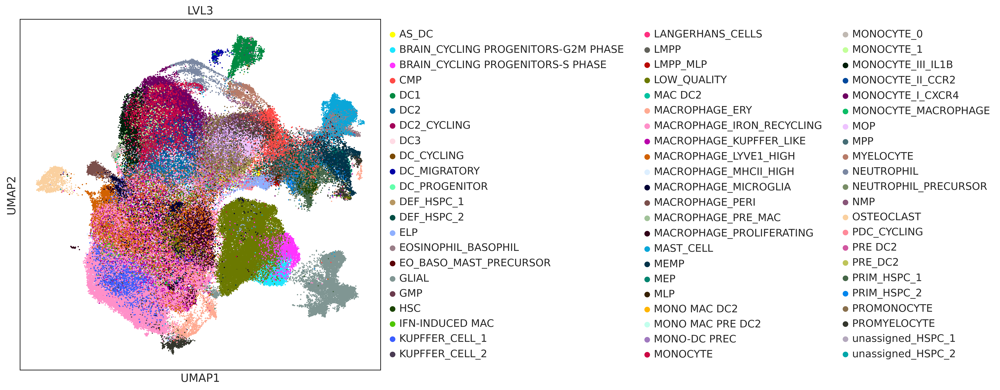

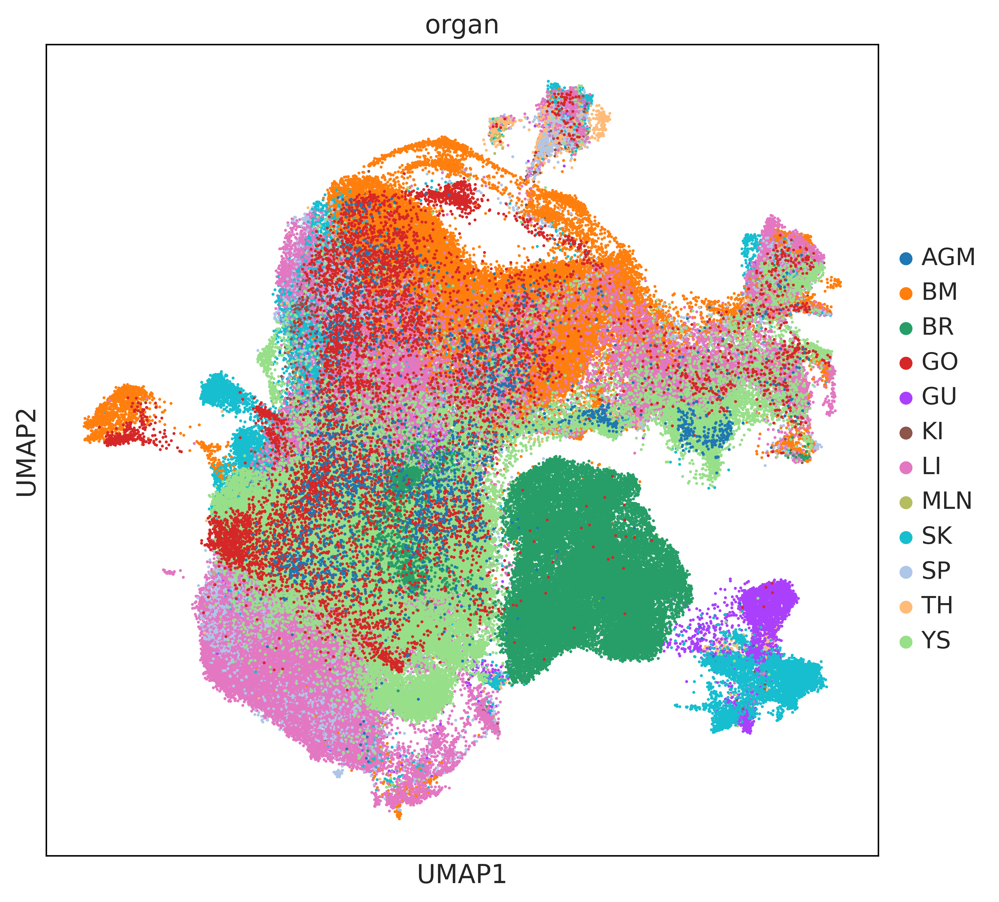

In [27]:
sc.pp.neighbors(adata, n_neighbors=40,use_rep='X_scvi', n_pcs = 20)
sc.tl.umap(adata)
# Clustering
# res = 5
sc.pl.umap(adata,color = 'LVL3',size =10)
sc.pl.umap(adata,color = 'organ',size =10)

In [140]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [141]:
import os,sys
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import scipy.sparse
import anndata
import seaborn as sns
# import scvelo as scv
## r2py setup
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
anndata2ri.activate()

In [142]:
import milopy.core as milo
import milopy.plot as milopl

In [143]:
figdir = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_030522_notebooks/Submission_figure_scripts/F1/scMILO/YS_milo/"
if os.path.exists(figdir):
    sc.settings.figdir = figdir
else:
    os.mkdir(figdir)
    sc.settings.figdir = figdir

In [144]:
## import project utils
cwd = '/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_030522_notebooks/Submission_figure_scripts/F1/scMILO/utils/'
sys.path.append(cwd)

import genes
import panfetal_utils

In [145]:
## r2py setup
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

In [146]:
%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [147]:
%%R
library(tidyverse)
library(reshape2)
library(patchwork)

remove_x_axis <- function(){
  theme(axis.text.x = element_blank(), axis.ticks.x = element_blank(), axis.title.x = element_blank())  
}

remove_y_axis <- function(){
  theme(axis.text.y = element_blank(), axis.ticks.y = element_blank(), axis.title.y = element_blank())  
}

In [148]:
import milopy

def annotate_nhoods(adata, anno_col):
    anno_dummies = pd.get_dummies(adata.obs[anno_col])
    anno_count = adata.obsm["nhoods"].T.dot(scipy.sparse.csr_matrix(anno_dummies.values))
    anno_frac = np.array(anno_count/anno_count.sum(1))

    anno_frac = pd.DataFrame(anno_frac, 
                             columns=anno_dummies.columns,
                             index=adata.uns["nhood_adata"].obs_names
                            )
    adata.uns["nhood_adata"].obsm["frac_annotation"] = anno_frac.values
    adata.uns["nhood_adata"].uns["annotation_labels"] = anno_frac.columns
    adata.uns["nhood_adata"].obs["nhood_annotation"] = anno_frac.idxmax(1)
    adata.uns["nhood_adata"].obs["nhood_annotation_frac"] = anno_frac.max(1)

## Load milo neighbourhoods

### Make neighbourhoods
Larger neighbourhoods than for analysis in time (more samples per condition)

In [149]:
order = ['3PCW',
 '4PCW',
 '5PCW',
 '6PCW',
 '7PCW',
 '8PCW',
 '9PCW',
'10PCW',
 '11PCW',
 '12PCW',
 '14PCW',
 '15PCW',
 '16PCW',
 '17PCW',
]
adata.obs["age"] = adata.obs["age"].astype('category').cat.reorder_categories(order)
adata.obs["stage_continuous"] = adata.obs["age"].astype('category').cat.codes
list(adata.obs["age"].astype('category').cat.codes.unique())

[9, 10, 8, 12, 11, 13, 6, 5, 4, 7, 3, 1, 2, 0]

In [150]:
adata.uns

OverloadedDict, wrapping:
	{'LVL3_colors': array(['#ffff00', '#1ce6ff', '#ff34ff', '#ff4a46', '#008941', '#006fa6',
       '#a30059', '#ffdbe5', '#7a4900', '#0000a6', '#63ffac', '#b79762',
       '#004d43', '#8fb0ff', '#997d87', '#5a0007', '#809693', '#6a3a4c',
       '#1b4400', '#4fc601', '#3b5dff', '#4a3b53', '#ff2f80', '#61615a',
       '#ba0900', '#6b7900', '#00c2a0', '#ffaa92', '#ff90c9', '#b903aa',
       '#d16100', '#ddefff', '#000035', '#7b4f4b', '#a1c299', '#300018',
       '#0aa6d8', '#013349', '#00846f', '#372101', '#ffb500', '#c2ffed',
       '#a079bf', '#cc0744', '#c0b9b2', '#c2ff99', '#001e09', '#00489c',
       '#6f0062', '#0cbd66', '#eec3ff', '#456d75', '#b77b68', '#7a87a1',
       '#788d66', '#885578', '#fad09f', '#ff8a9a', '#d157a0', '#bec459',
       '#456648', '#0086ed', '#886f4c', '#34362d', '#b4a8bd', '#00a6aa'],
      dtype=object), 'neighbors': {'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'method': 'umap', 'metric': 'euclidea

In [151]:
## Construct neighbourhoods
adata.uns['scvi_'] = adata.uns['neighbors'] 
adata.obsp['scvi__connectivities'] = adata.obsp['connectivities'] 
adata.obsp['scvi__distances'] = adata.obsp['distances'] 
milo.make_nhoods(adata, neighbors_key="scvi_", prop=0.05)

In [152]:
adata.obs['sample'] = adata.obs['donor'].astype(str) + '_'+adata.obs['organ'].astype(str)
adata.obs['sample'] = adata.obs['sample'].astype("category")

In [153]:
# ## Recompute KNN graph
# sc.pp.neighbors(adata, use_rep = "X_scvi", n_neighbors = 100, key_added="scvi")

# ## Construct neighbourhoods
# milo.make_nhoods(adata, neighbors_key="scvi", prop=0.05)

## Count cells in neighbourhoods
milo.count_nhoods(adata, sample_col="sample")

/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


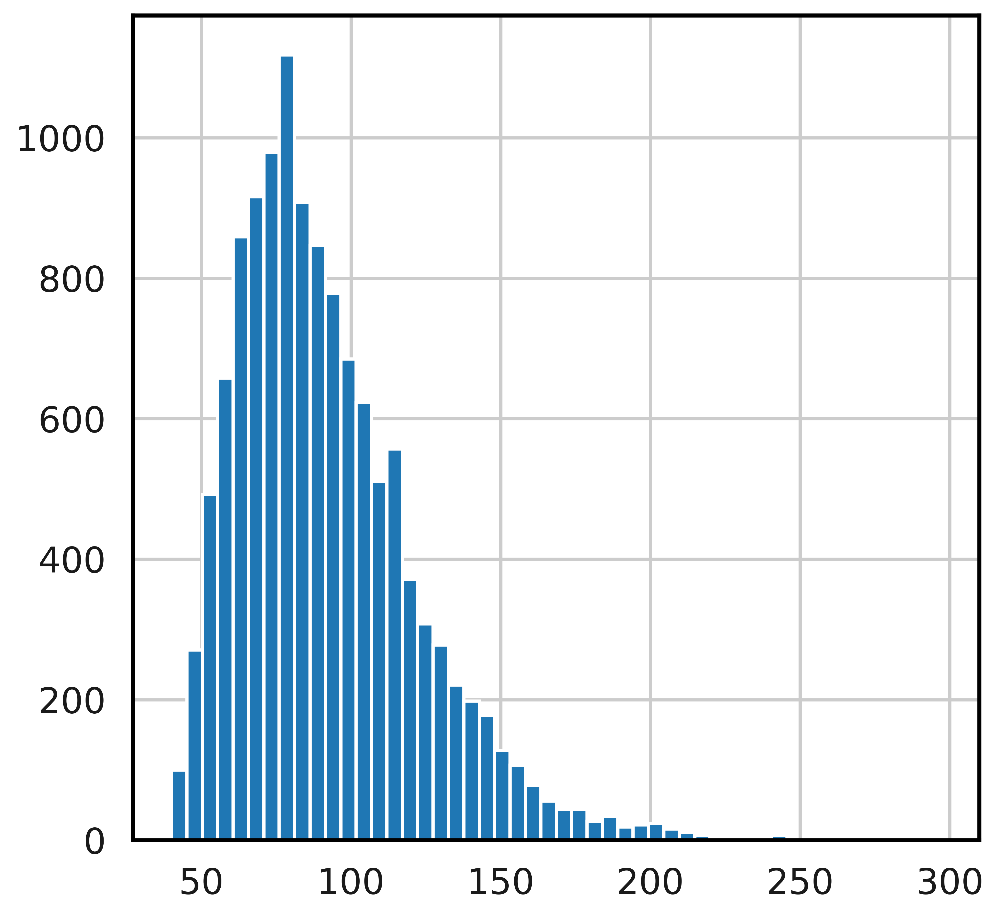

In [154]:
nhood_size = np.array(adata.obsm["nhoods"].sum(0)).ravel()
plt.hist(nhood_size, bins=50);

### Test for enrichment of an organ

In [156]:
import milopy.core as milo
import milopy.plot as milopl

In [157]:
adata.obs

,file,name,uniform_label,uniform_label_expanded_merged,uniform_label_lvl0,organ,Sample.lanes,Sort_id,age,method,...,X_clus_prediction,LVL1,LVL2,LVL3,LVL4,LVL5,stage_continuous,nhood_ixs_random,nhood_ixs_refined,nhood_kth_distance
FCAImmP7579224-ATTACTCTCGATGAGG,FCAImmP7579224,FCAImmP7579224_filtered.h5ad,nan,nan,nan,SK,FCAImmP7579224,CD45P,12PCW,5GEX,...,nan,MYELOID,DC,DC_CYCLING,DC_CYCLING,DC_CYCLING,9,0,0,0.0
FCAImmP7579224-TGCTACCTCATGTAGC,FCAImmP7579224,FCAImmP7579224_filtered.h5ad,nan,nan,nan,SK,FCAImmP7579224,CD45P,12PCW,5GEX,...,nan,MYELOID,DC2,PRE_DC2,PRE_DC2,PRE_DC2,9,0,0,0.0
FCAImmP7579224-ACGGCCACAAGCTGAG,FCAImmP7579224,FCAImmP7579224_filtered.h5ad,nan,nan,nan,SK,FCAImmP7579224,CD45P,12PCW,5GEX,...,nan,MYELOID,MONOCYTE,MONOCYTE_II_CCR2,MONOCYTE_II_CCR2,MONOCYTE_II_CCR2,9,0,0,0.0
FCAImmP7579224-ATTATCCAGGTTACCT,FCAImmP7579224,FCAImmP7579224_filtered.h5ad,nan,nan,nan,SK,FCAImmP7579224,CD45P,12PCW,5GEX,...,nan,MYELOID,DC,DC_CYCLING,DC_CYCLING,DC_CYCLING,9,0,0,0.0
FCAImmP7579224-GGAGCAACAATGGACG,FCAImmP7579224,FCAImmP7579224_filtered.h5ad,nan,nan,nan,SK,FCAImmP7579224,CD45P,12PCW,5GEX,...,nan,MYELOID,DC,DC1,DC1,DC1,9,1,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTCCTCCAGACAGGT-3,nan,nan,nan,nan,nan,AGM,nan,nan,5PCW,nan,...,HSPC_1_ys_HL,PROGENITOR,HSPC,HSC,HSC,HSC,2,0,0,0.0
TTTCCTCTCGGCGCTA-3,nan,nan,nan,nan,nan,AGM,nan,nan,5PCW,nan,...,Macrophage_ys_HL,MYELOID,MACROPHAGE,MACROPHAGE_LYVE1_HIGH,MACROPHAGE_PRE_AGM,MACROPHAGE_PRE_AGM,2,0,0,0.0
TTTGCGCTCGTCCGTT-3,nan,nan,nan,nan,nan,AGM,nan,nan,5PCW,nan,...,Lymphoid_progenitor_ys_HL,PROGENITOR,ELP,ELP,ELP,ELP,2,0,0,0.0
TTTGGTTTCAGTTGAC-3,nan,nan,nan,nan,nan,AGM,nan,nan,5PCW,nan,...,HSPC_2_ys_HL,PROGENITOR,MPP,MPP,MPP,MPP,2,0,0,0.0


In [158]:
adata.obs['age'] = adata.obs['age'].astype(str)
adata.obs.loc[adata.obs['donor'].isin(['F61']),'age'] = '6PCW'

In [159]:
pd.set_option('display.max_rows', 124)
adata.obs.groupby(['donor','age']).apply(len)

donor                    age  
CS12_Diencephalon        4PCW       185
CS12_Hindbrain           4PCW       632
CS12_Midbrain            4PCW       405
CS12_OpticVesicle        4PCW       135
CS12_Telencephalon       4PCW        79
CS13_AnteriorMidbrain    4PCW      1493
CS13_CentralMidbrain     4PCW       313
CS13_OlfactoryPacode     4PCW        14
CS13_OpticVesicle        4PCW        41
CS13_hindbrain           4PCW       765
CS13_prosencephalon      4PCW       295
CS14_cortex              5PCW        27
CS14_hindbrain           5PCW        35
CS14_retina              5PCW        35
CS15_1                   5PCW       906
CS15_2                   5PCW       605
CS15_2_cortex            5PCW      1142
CS15_2_hindbrain         5PCW      1453
CS15_2_subpallium        5PCW      1320
CS15_2_thalamus          5PCW      1404
CS15_3                   5PCW       324
CS15_4                   5PCW      1068
CS19_cortex              6PCW      1645
CS19_hindbrain           6PCW        86
CS19_midb

In [160]:
adata.obs.loc[adata.obs['donor'].isin(['CS12_Diencephalon']),'organ'].unique()

['BR']
Categories (12, object): ['AGM', 'BM', 'BR', 'GO', ..., 'SK', 'SP', 'TH', 'YS']

In [161]:
# milo.DA_nhoods(adata, design="~stage_continuous")

In [162]:
adata.obs['sample'] = adata.obs['donor'].astype(str) + '_'+adata.obs['organ'].astype(str)
adata.obs['sample'] = adata.obs['sample'].astype("category")
adata.obs['organ'] = adata.obs['organ'].astype("category")
adata.obs['donor'] = adata.obs['donor'].astype("category")
milopy.utils.add_covariate_to_nhoods_var(adata, [ 'donor','organ'])
adata.uns['nhood_adata'].var['organ'] = adata.uns['nhood_adata'].var['organ'].astype('category')
all_organs = adata.obs.organ.unique().tolist()
design = '~ organ + stage_continuous'


## Calculate logFC and SpatialFDR within each organ
milo_res_dict = {}
for org in all_organs:
    print(org)
    if org == adata.uns['nhood_adata'].var.organ.cat.categories[0]:
        nhood_adata = adata.uns['nhood_adata'].copy()
        new_cats = nhood_adata.var.organ.cat.categories[1:].tolist()
        new_cats.append(org)
        nhood_adata.var.organ.cat.reorder_categories(new_cats, inplace=True)
        adata.obs.organ.cat.reorder_categories(new_cats, inplace=True)
        adata.uns['nhood_adata'] = nhood_adata.copy()
#     _milo_test_organ_abundance(adata, org, design)
    milo.DA_nhoods(adata, design=design, model_contrasts='organ{o}'.format(o=org))
    milo_res_dict[org] = adata.uns["nhood_adata"].obs.copy()

SK


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


SP


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


LI


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


GU


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


BM


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


KI


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


MLN


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


YS


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


BR


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


GO


/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


AGM


/tmp/ipykernel_1479/673200478.py:19: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  nhood_adata.var.organ.cat.reorder_categories(new_cats, inplace=True)
/tmp/ipykernel_1479/673200478.py:20: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs.organ.cat.reorder_categories(new_cats, inplace=True)
/home/jovyan/my-conda-envs/milo/lib/python3.10/site-packages/milopy/core.py:246: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


In [163]:
## Collapse results
logFC_df_ls = [v["logFC"] for k,v in milo_res_dict.items()]
for k,v in milo_res_dict.items():
    milo_res_dict[k]["logFC_" + k] = milo_res_dict[k]["logFC"].copy()
    milo_res_dict[k]["SpatialFDR_" + k] = milo_res_dict[k]["SpatialFDR"].copy()

org_fc = pd.concat([v[["logFC_" + k]] for k,v in milo_res_dict.items()], 1)
org_fdr = pd.concat([v[["SpatialFDR_" + k]] for k,v in milo_res_dict.items()], 1)

/tmp/ipykernel_1479/1409109814.py:7: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  org_fc = pd.concat([v[["logFC_" + k]] for k,v in milo_res_dict.items()], 1)
/tmp/ipykernel_1479/1409109814.py:8: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  org_fdr = pd.concat([v[["SpatialFDR_" + k]] for k,v in milo_res_dict.items()], 1)


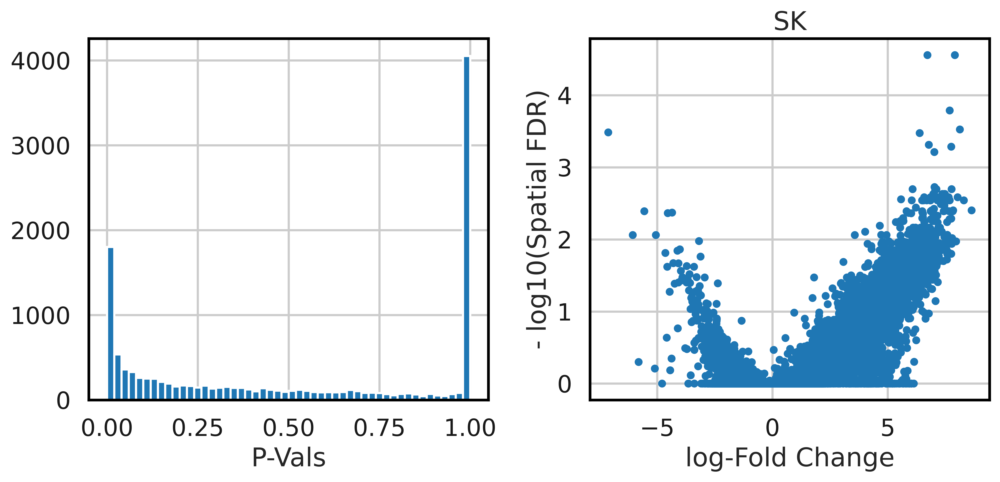

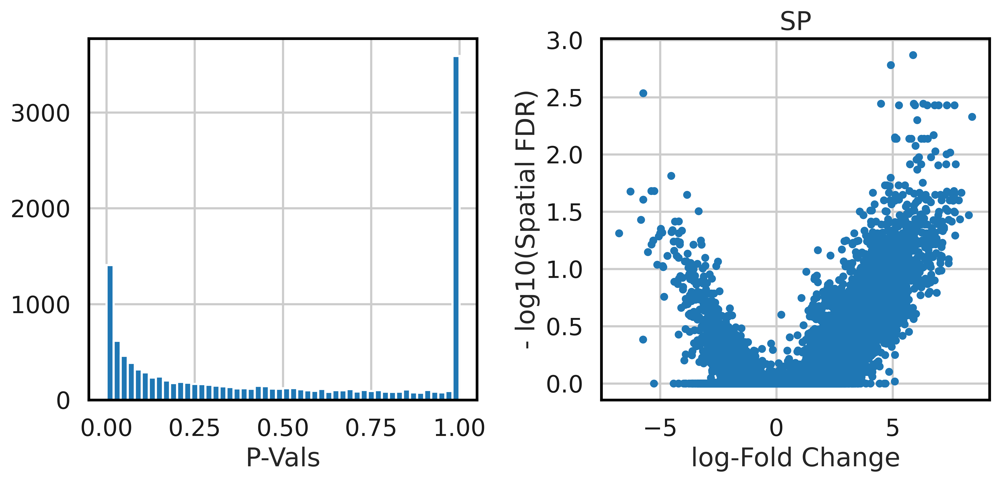

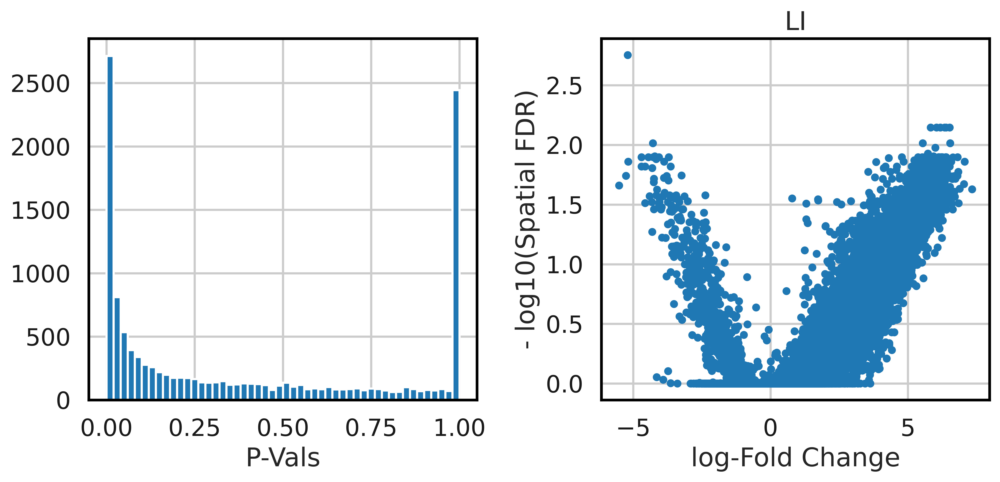

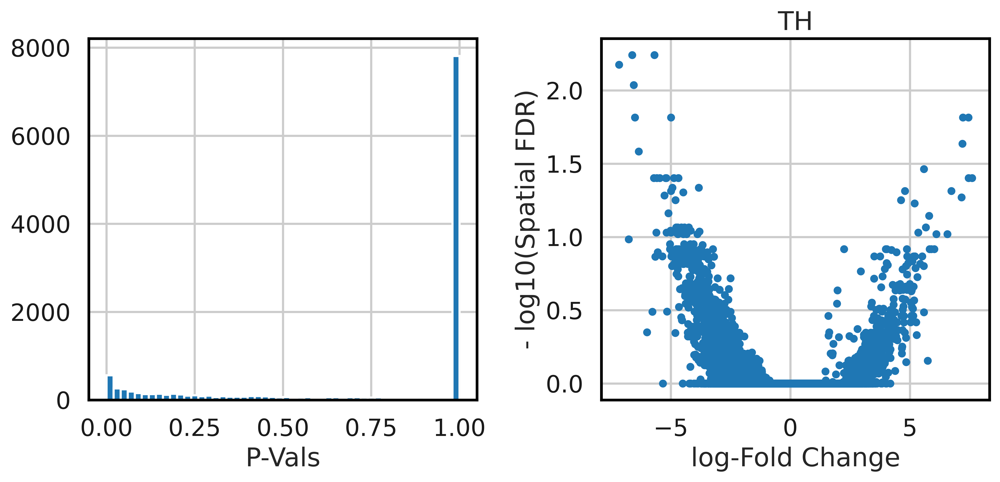

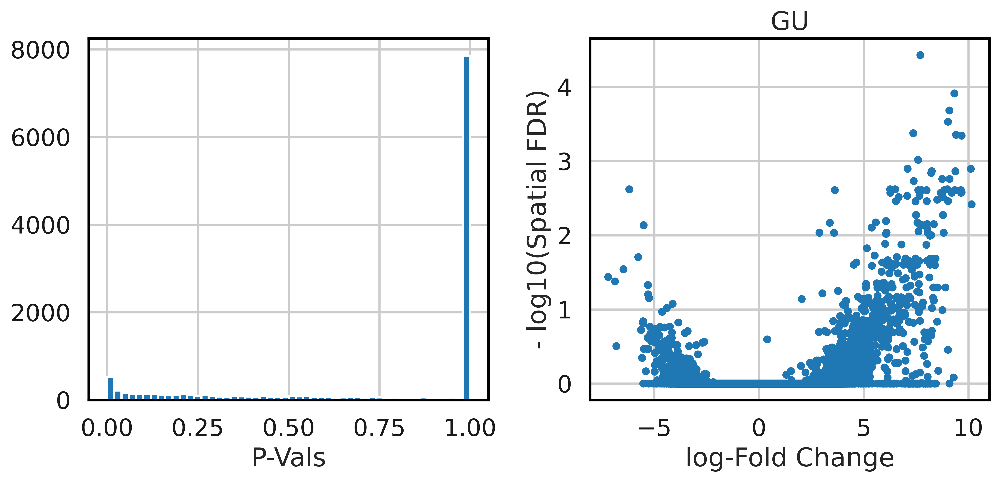

...

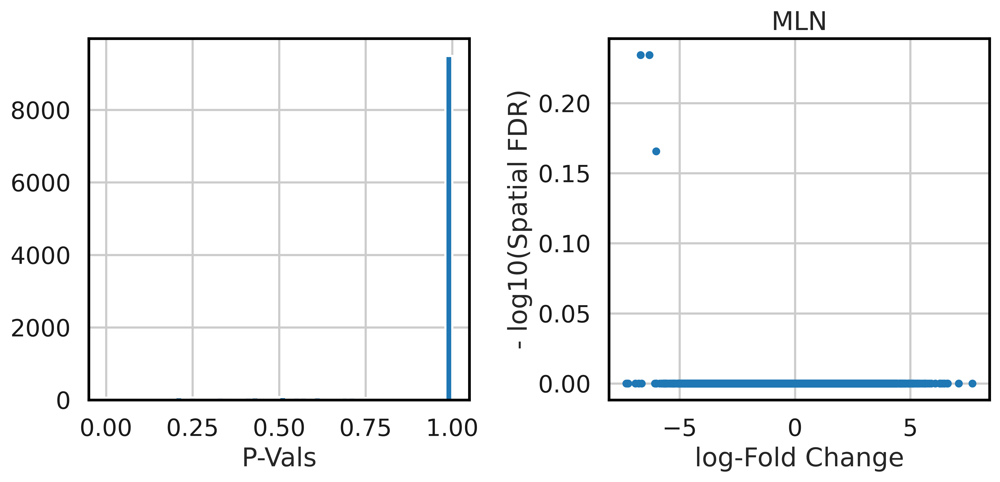

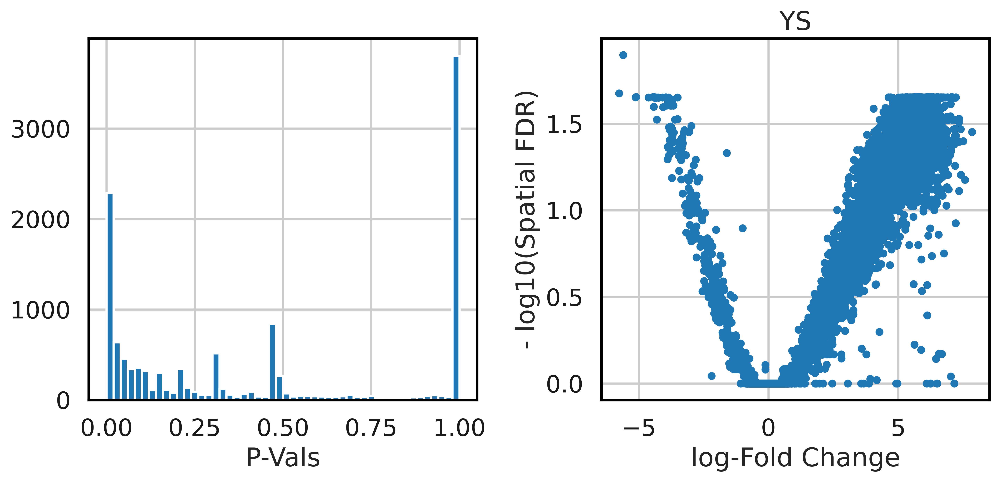

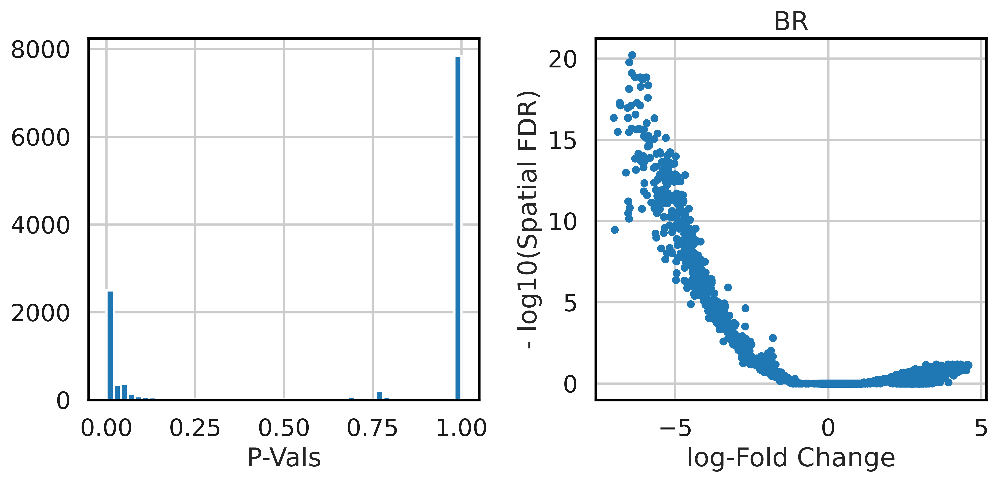

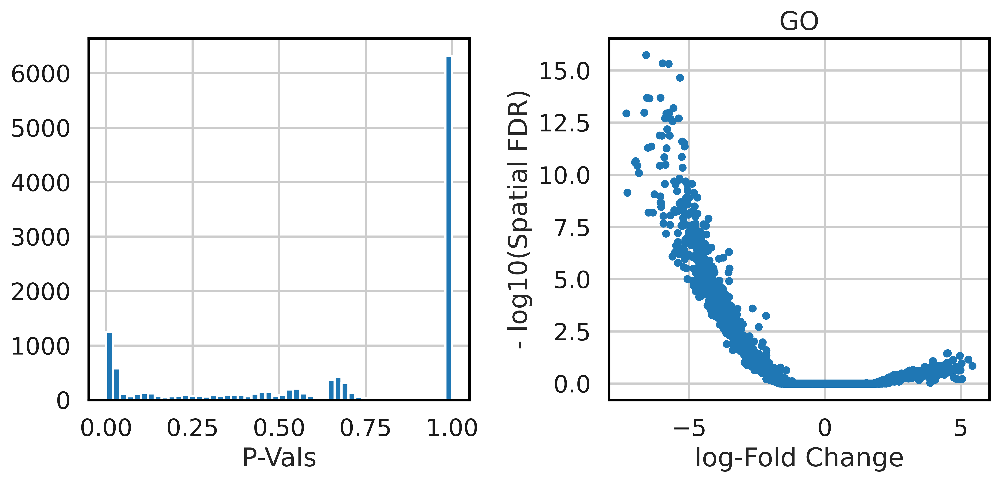

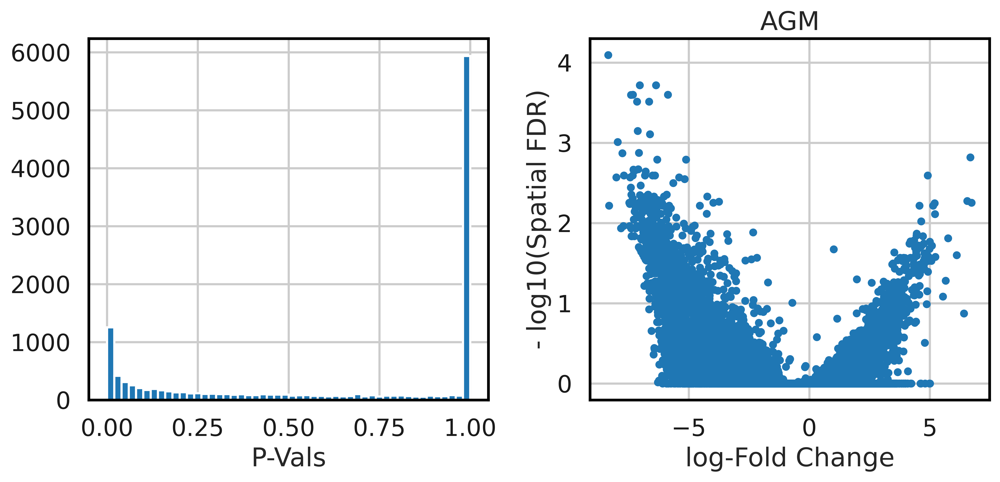

In [164]:
old_figsize = plt.rcParams["figure.figsize"]
for org, milo_res in milo_res_dict.items():
    plt.rcParams["figure.figsize"] = [10,5]
    plt.subplot(1,2,1)
    plt.hist(milo_res.PValue, bins=50);
    plt.xlabel("P-Vals");
    plt.subplot(1,2,2)
    plt.plot(milo_res.logFC, -np.log10(milo_res.SpatialFDR), '.');
    plt.xlabel("log-Fold Change");
    plt.ylabel("- log10(Spatial FDR)");
    plt.title(org);
    plt.tight_layout();
    plt.show()

plt.rcParams["figure.figsize"] = old_figsize

### Plot graph embeddings

In [165]:
nhood_adata

AnnData object with n_obs × n_vars = 12491 × 170
    obs: 'index_cell', 'kth_distance', 'SpatialFDR', 'logFC', 'logCPM', 'F', 'PValue', 'FDR'
    var: 'stage_continuous', 'organ', 'sample'
    uns: 'sample_col'

In [166]:
milopy.utils.build_nhood_graph(adata)

In [167]:
# plt.rcParams["figure.figsize"] = [10,10]
# milopy.utils.build_nhood_graph(adata)
# for org, milo_res in milo_res_dict.items():
#     adata.uns['nhood_adata'].obs = milo_res.copy()
#     adata.uns["nhood_adata"].obs["Nhood_size"] = np.array(adata.obsm["nhoods"].sum(0)).flatten()
#     milopl.plot_nhood_graph(adata, alpha=0.05, 
#                             min_logFC= 0, min_size=0.5, title=org)

In [169]:
alpha = 0.05
min_logFC = 0
min_size=0.5
plot_edges = False

In [170]:
def plot_nhood_graph_enrichment(nhood_adata, alpha = 0.05,
    min_logFC = 0,
    min_size=0.5,
    plot_edges = False,
    title='ciao',**kwargs):
#     nhood_adata = adata.uns["nhood_adata"].copy()

    nhood_adata.obs["graph_color"] = nhood_adata.obs["logFC"]
    nhood_adata.obs.loc[nhood_adata.obs["SpatialFDR"] > alpha, "graph_color"] = np.nan
    nhood_adata.obs["abs_logFC"] = abs(nhood_adata.obs["logFC"])
    nhood_adata.obs.loc[nhood_adata.obs["abs_logFC"] < min_logFC, "graph_color"] = np.nan
    nhood_adata.obs.loc[nhood_adata.obs["logFC"] < 0, "graph_color"] = np.nan

    ## Plotting order - extreme logFC on top
    nhood_adata.obs.loc[nhood_adata.obs["graph_color"].isna(), "abs_logFC"] = np.nan
    ordered = nhood_adata.obs.sort_values('abs_logFC', na_position='first').index
    nhood_adata = nhood_adata[ordered]

#     vmax = np.max([nhood_adata.obs["graph_color"].max(), abs(nhood_adata.obs["graph_color"].min())])
    vmin = 0

    sc.pl.embedding(nhood_adata, "X_milo_graph", 
                    color="graph_color", cmap="Reds",
                    size=nhood_adata.obs["Nhood_size"]*min_size, 
                    edges=plot_edges, neighbors_key="nhood",
                    # edge_width = 
                    sort_order=False,
                    frameon=False,
#                     vmax=vmax, 
                    vmin=vmin,
                    title=title,
                    **kwargs
                   )

# Annotate neighbourhoods

In [196]:
adata.obs['LVL4'] = adata.obs['LVL4'].str.replace( 'KUPFFER_CELL_1','MACROPHAGE_KUPFFER_LIKE')
adata.obs['LVL4'] = adata.obs['LVL4'].str.replace( 'KUPFFER_CELL_2','MACROPHAGE_KUPFFER_LIKE')

In [197]:
import milopy

def annotate_nhoods(adata, anno_col):
    anno_dummies = pd.get_dummies(adata.obs[anno_col])
    anno_count = adata.obsm["nhoods"].T.dot(scipy.sparse.csr_matrix(anno_dummies.values))
    anno_frac = np.array(anno_count/anno_count.sum(1))

    anno_frac = pd.DataFrame(anno_frac, 
                             columns=anno_dummies.columns,
                             index=adata.uns["nhood_adata"].obs_names
                            )
    adata.uns["nhood_adata"].obsm["frac_annotation"] = anno_frac.values
    adata.uns["nhood_adata"].uns["annotation_labels"] = anno_frac.columns
    adata.uns["nhood_adata"].obs["nhood_annotation"] = anno_frac.idxmax(1)
    adata.uns["nhood_adata"].obs["nhood_annotation_frac"] = anno_frac.max(1)

milopy.utils.annotate_nhoods(adata, anno_col='LVL4')

In [173]:
sorted(list(adata.uns["nhood_adata"].obs['nhood_annotation'].astype(str).unique()))

['AS_DC',
 'BRAIN_CYCLING PROGENITORS-G2M PHASE',
 'BRAIN_CYCLING PROGENITORS-S PHASE',
 'CMP',
 'DC1',
 'DC2',
 'DC3',
 'DC_CYCLING',
 'DC_MIGRATORY',
 'DEF_HSPC_1',
 'DEF_HSPC_2',
 'ELP',
 'EOSINOPHIL_BASOPHIL',
 'GLIAL',
 'GMP',
 'HSC',
 'IFN-INDUCED MAC',
 'LMPP',
 'LMPP_MLP',
 'LOW_QUALITY',
 'MACROPHAGE_ERY',
 'MACROPHAGE_IRON_RECYCLING',
 'MACROPHAGE_KUPFFER_LIKE',
 'MACROPHAGE_LYVE1_HIGH',
 'MACROPHAGE_MHCII_HIGH',
 'MACROPHAGE_MICROGLIA',
 'MACROPHAGE_PERI',
 'MACROPHAGE_PRE_AGM',
 'MACROPHAGE_PROLIFERATING',
 'MAST_CELL',
 'MEMP',
 'MEP',
 'MLP',
 'MONO MAC DC2',
 'MONO MAC PRE DC2',
 'MONO-DC PREC',
 'MONOCYTE',
 'MONOCYTE_0',
 'MONOCYTE_1',
 'MONOCYTE_III_IL1B',
 'MONOCYTE_II_CCR2',
 'MONOCYTE_I_CXCR4',
 'MOP',
 'MPP',
 'MYELOCYTE',
 'NEUTROPHIL',
 'NMP',
 'OSTEOCLAST',
 'PDC_CYCLING',
 'PRE DC2',
 'PRE_DC2',
 'PRIM_HSPC_1',
 'PRIM_HSPC_2',
 'PROMONOCYTE',
 'PROMYELOCYTE']

In [214]:
# nhood_adata.obs["Nhood_size"]= np.array(adata.obsm["nhoods"].sum(0)).flatten()
# nhood_adata.obsm['X_milo_graph'] = adata.uns['nhood_adata'].obsm['X_milo_graph']
nhood_adata = adata.uns['nhood_adata']
vmin = 0

In [215]:
nhood_adata.obs

,index_cell,kth_distance,SpatialFDR,logFC,logCPM,F,PValue,FDR,logFC_AGM,SpatialFDR_AGM,Nhood_size,nhood_annotation,nhood_annotation_frac
0,FCAImmP7579224-GACACGCGTAGCGTCC,2.024933,0.983889,-1.652704,10.591106,1.338397e+00,0.287645,0.952285,-1.652704,0.983889,90.0,DC_CYCLING,0.555556
1,FCAImmP7579224-TTAGGCAAGCGTGAGT,2.333559,1.000000,1.882690,10.466183,2.564531e-08,0.999873,1.000000,1.882690,1.000000,53.0,DC_CYCLING,0.905660
2,FCAImmP7579224-GAGCAGATCTACTATC,2.211167,1.000000,2.782600,10.666097,3.165281e-08,0.999858,1.000000,2.782600,1.000000,79.0,DC2,0.949367
3,FCAImmP7579224-GTATCTTTCTTAGCCC,2.264541,1.000000,0.854074,10.569605,2.025206e-01,0.653491,1.000000,0.854074,1.000000,75.0,PROMONOCYTE,0.840000
4,FCAImmP7579224-GCACATACAGTAAGAT,2.406481,1.000000,2.463550,10.626982,2.021550e-07,0.999762,1.000000,2.463550,1.000000,67.0,DC2,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
12486,ACGGGCTCAGGGTTAG-3,2.125663,0.662514,2.958364,10.704574,2.084641e+00,0.150604,0.647747,2.958364,0.662514,86.0,MACROPHAGE_PRE_AGM,0.244186
12487,ACTTACTGTCCGACGT-3,1.691057,0.070719,4.888903,10.690024,8.758827e+00,0.003786,0.073414,4.888903,0.070719,93.0,HSC,0.645161
12488,AGACGTTGTTAAAGAC-3,1.607636,1.000000,2.962693,10.692202,1.217486e+00,0.698305,1.000000,2.962693,1.000000,105.0,HSC,0.733333
12489,GCGAGAAGTGCCTTGG-3,1.747043,1.000000,4.807459,10.576607,4.955875e+00,0.809481,1.000000,4.807459,1.000000,60.0,HSC,0.833333


In [216]:
adata.uns["nhood_adata"].obs['nhood_annotation'].unique()
list(adata.uns["nhood_adata"].obs.loc[adata.uns["nhood_adata"].obs['nhood_annotation'].str.contains('MAC'),'nhood_annotation'].unique())

['MACROPHAGE_LYVE1_HIGH',
 'MACROPHAGE_MHCII_HIGH',
 'MACROPHAGE_PRE_AGM',
 'MACROPHAGE_IRON_RECYCLING',
 'MACROPHAGE_PROLIFERATING',
 'MACROPHAGE_KUPFFER_LIKE',
 'MACROPHAGE_ERY',
 'MACROPHAGE_PERI',
 'IFN-INDUCED MAC',
 'MONO MAC PRE DC2',
 'MONO MAC DC2',
 'MACROPHAGE_MICROGLIA']

In [179]:
list(adata.obs.loc[adata.obs['LVL4'].str.contains('MAC'),'LVL4'].unique())

['MACROPHAGE_PROLIFERATING',
 'MACROPHAGE_MHCII_HIGH',
 'MACROPHAGE_LYVE1_HIGH',
 'MACROPHAGE_PRE_AGM',
 'MACROPHAGE_PERI',
 'MACROPHAGE_ERY',
 'MACROPHAGE_IRON_RECYCLING',
 'MACROPHAGE_KUPFFER_LIKE',
 'MACROPHAGE_MICROGLIA',
 'MONO MAC PRE DC2',
 'MACROPHAGE_PRE_MAC',
 'MONOCYTE_MACROPHAGE',
 'MONO MAC DC2',
 'MAC DC2',
 'IFN-INDUCED MAC']

In [ ]:
plt.rcParams["figure.figsize"] = [7,7]
sns.set_context("talk")
sc.pl.embedding(nhood_adata, "X_milo_graph", 
                color="nhood_annotation",
                size=nhood_adata.obs["Nhood_size"]*min_size, 
                edges=plot_edges, neighbors_key="nhood",
                # edge_width = 
                sort_order=False,
                frameon=False,
#                     vmax=vmax, 
                vmin=0,
                title='',
                legend_loc="on data",
                save='nhood_graph_mono_anno.pdf'
               )


# milopy.utils.build_nhood_graph(adata)
for org, milo_res in milo_res_dict.items():
    adata.uns['nhood_adata'].obs = milo_res.copy()
    adata.uns["nhood_adata"].obs["Nhood_size"] = np.array(adata.obsm["nhoods"].sum(0)).flatten()
    annotate_nhoods(adata, anno_col="LVL4")
#     nhood_adata = adata.uns["nhood_adata"][adata.uns["nhood_adata"].obs['nhood_annotation'].isin(anno_group_myeloid['Mono'])].copy()
    plot_nhood_graph_enrichment(nhood_adata, alpha=0.05, min_logFC= 0, min_size=0.5, title=org, 
                                save='nhood_graph_mono_{o}.pdf'.format(o=org))

In [217]:
# milopy.utils.build_nhood_graph(adata)
for org, milo_res in milo_res_dict.items():
    adata.uns['nhood_adata'].obs = milo_res.copy()
    adata.uns["nhood_adata"].obs["Nhood_size"] = np.array(adata.obsm["nhoods"].sum(0)).flatten()
    annotate_nhoods(adata, anno_col="LVL4")

In [ ]:
plt.rcParams["figure.figsize"] = [10,10]
sns.set_context("talk")

# milopy.utils.build_nhood_graph(adata)
for org, milo_res in milo_res_dict.items():
    adata.uns['nhood_adata'].obs = milo_res.copy()
    adata.uns["nhood_adata"].obs["Nhood_size"] = np.array(adata.obsm["nhoods"].sum(0)).flatten()
    annotate_nhoods(adata, anno_col="LVL4")
    nhood_adata = adata.uns["nhood_adata"].copy()
    plot_nhood_graph_enrichment(nhood_adata, alpha=0.05, min_logFC= 0, min_size=0.5, title=org, 
                                save='nhood_graph_{o}.pdf'.format(o=org))

# Annotate neighbourhoods

In [228]:
import milopy

def annotate_nhoods(adata, anno_col):
    anno_dummies = pd.get_dummies(adata.obs[anno_col])
    anno_count = adata.obsm["nhoods"].T.dot(scipy.sparse.csr_matrix(anno_dummies.values))
    anno_frac = np.array(anno_count/anno_count.sum(1))

    anno_frac = pd.DataFrame(anno_frac, 
                             columns=anno_dummies.columns,
                             index=adata.uns["nhood_adata"].obs_names
                            )
    adata.uns["nhood_adata"].obsm["frac_annotation"] = anno_frac.values
    adata.uns["nhood_adata"].uns["annotation_labels"] = anno_frac.columns
    adata.uns["nhood_adata"].obs["nhood_annotation"] = anno_frac.idxmax(1)
    adata.uns["nhood_adata"].obs["nhood_annotation_frac"] = anno_frac.max(1)

milopy.utils.annotate_nhoods(adata, anno_col='LVL4')

In [229]:
nhood_adata = adata.uns['nhood_adata']

In [230]:
# milopy.utils.build_nhood_graph(adata)
for org, milo_res in milo_res_dict.items():
    adata.uns['nhood_adata'].obs = milo_res.copy()
    adata.uns["nhood_adata"].obs["Nhood_size"] = np.array(adata.obsm["nhoods"].sum(0)).flatten()
    annotate_nhoods(adata, anno_col="LVL4")

In [219]:
# ## Read annotation groupings
# import json
# with open('../../metadata/anno_groups.json', 'r') as json_file:
#     anno_groups_dict = json.load(json_file)
# anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}
    

In [231]:
org_fc = pd.concat([v[["logFC_" + k]] for k,v in milo_res_dict.items()], 1)
org_fdr = pd.concat([v[["SpatialFDR_" + k]] for k,v in milo_res_dict.items()], 1)

/tmp/ipykernel_1479/2186457576.py:1: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  org_fc = pd.concat([v[["logFC_" + k]] for k,v in milo_res_dict.items()], 1)
/tmp/ipykernel_1479/2186457576.py:2: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  org_fdr = pd.concat([v[["SpatialFDR_" + k]] for k,v in milo_res_dict.items()], 1)


In [232]:
org_fc_filtered = org_fc.copy()
org_fc_filtered.values[org_fdr.values > 0.1] = 0

In [233]:
anno_groups_dict_rev = dict(zip((adata.obs['LVL4']),(adata.obs['LVL2'])))

In [234]:
## Add annotation
# annotate_nhoods(adata, anno_col="anno_lvl_2_final_clean")
org_fc_filtered["nhood_anno"] = adata.uns["nhood_adata"].obs["nhood_annotation"]
org_fc_filtered.loc[adata.uns["nhood_adata"].obs["nhood_annotation_frac"] < 0.5, "nhood_anno"] = "Mixed"

org_fc_filtered['anno_group'] = [anno_groups_dict_rev[x] if x!="Mixed" else np.nan for x in org_fc_filtered['nhood_anno']]
#org_fc_filtered['anno_group'] = org_fc_filtered["nhood_anno"].map(anno_groups_dict_rev)

In [238]:
progen_groups = [
 'CMP',
 'DEF_HSPC_1',
 'DEF_HSPC_2',
 'ELP',
 'GMP',
 'HSC',
 'LMPP_MLP',
 'MEMP',
 'MEP',
 'MLP',
 'MOP',
 'MPP',
 'MYELOCYTE',
 'NMP',
 'PRIM_HSPC_1',
 'PRIM_HSPC_2',
 'PROMONOCYTE',
 'PROMYELOCYTE'] 

In [239]:
org_fc_filtered['anno_group']

0                 DC
1                 DC
2                 DC
3        PROMONOCYTE
4                 DC
            ...     
12486            NaN
12487           HSPC
12488           HSPC
12489           HSPC
12490            NaN
Name: anno_group, Length: 10887, dtype: object

In [240]:
(org_fc_filtered.loc[org_fc_filtered['anno_group'].isin(progen_groups),'nhood_anno'])

3         PROMONOCYTE
7         PROMONOCYTE
94       PROMYELOCYTE
175               MEP
179              MEMP
             ...     
12459     PROMONOCYTE
12462     PROMONOCYTE
12469     PROMONOCYTE
12482     PROMONOCYTE
12483     PROMONOCYTE
Name: nhood_anno, Length: 1175, dtype: object

In [255]:

%%R -i org_fc_filtered -i org_fdr -h 1000 -w 800

long_org_fc <- org_fc_filtered %>%
    rowid_to_column("Nhood") %>%
    pivot_longer(cols= - c(nhood_anno, anno_group, Nhood), names_to="organ", values_to="logFC") %>%
    mutate(organ=str_remove(organ, "logFC_")) 

long_org_fdr <- org_fdr %>%
    rowid_to_column("Nhood") %>%
    pivot_longer(cols= - c(Nhood), names_to="organ", values_to="SpatialFDR") %>%
    mutate(organ=str_remove(organ, "SpatialFDR_")) 
    
plot_df <- left_join(long_org_fc, long_org_fdr) %>%
    filter(!is.na(logFC)) %>%
    filter(nhood_anno!="nan") %>%
    filter(nhood_anno!="Mixed") %>%
    ## Fix organ naming and order 
    mutate(organ=factor(organ, levels=c("YS", "LI", "AGM","BR","GO","SK", "TH", "SP", "BM", "MLN", "KI", "GU"))) %>%
    ## Fix some names
    mutate(nhood_anno=ifelse(str_detect(nhood_anno, "NK$"), "NK", nhood_anno)) %>%
    ## Reorder by fold-change 
    group_by(organ, nhood_anno, Nhood) %>%
    mutate(mean_logFC = mean(logFC)) %>%
    ungroup() %>%
    group_by(organ, nhood_anno) %>%
    arrange(- mean_logFC) %>%
    ungroup()  %>%
    mutate(Nhood=factor(Nhood, levels=unique(Nhood))) %>%
    group_by(nhood_anno) %>%
    filter(length(unique(Nhood)) > 20) %>%
    ungroup()

head(plot_df)

Joining, by = c("Nhood", "organ")
# A tibble: 6 × 7
  Nhood nhood_anno                anno_group  organ logFC SpatialFDR mean_logFC
  <fct> <chr>                     <chr>       <fct> <dbl>      <dbl>      <dbl>
1 7398  MACROPHAGE_KUPFFER_LIKE   MACs        GU     9.09  0.00173         9.09
2 4945  MACROPHAGE_PRE_AGM        YS_enriched SK     8.64  0.00394         8.64
3 1310  MACROPHAGE_MHCII_HIGH     MACs        GU     8.51  0.00330         8.51
4 2037  MACROPHAGE_IRON_RECYCLING MACs        SP     8.42  0.00469         8.42
5 6090  MACROPHAGE_LYVE1_HIGH     MACs        GU     8.40  0.0252          8.40
6 2419  MACROPHAGE_LYVE1_HIGH     MACs        BM     8.34  0.0000805       8.34


In [256]:
%%R -w 1200 -h 600 -i figdir -o pl_df -o plot_df
# library(ggbeeswarm)
# organ_colors_df <- read.csv("./organ_colors.csv")
# organ_palette <- setNames(organ_colors_df$color, organ_colors_df$organ)

# anno_group_order <- c('YS_enriched','MACs','DCs', 'Mono','Progenitors', 'other')

# pl_df <- plot_df %>%
#     mutate(logFC=ifelse(logFC > 0, logFC, 0)) %>%
#     ## Reorder annotation names by median FC
#     group_by(nhood_anno) %>%
#     mutate(mean_logFC = median(logFC)) %>%
#     ungroup() %>%
#     arrange(mean_logFC) %>%
#     mutate(nhood_anno=factor(nhood_anno, levels=unique(nhood_anno))) %>%
#     ## Calculate median per organ, to plot
#     group_by(organ, nhood_anno) %>%
#     mutate(mean_logFC = median(logFC)) %>%
#     ungroup() %>%
#     mutate(anno_group=factor(anno_group, levels=anno_group_order)) %>%
#     filter(!is.na(anno_group)) %>%
#     filter(anno_group %in% anno_group_order)
    
    
# %%R -w 1200 -h 600 -i figdir -o pl_df
library(ggbeeswarm)
organ_colors_df <- read.csv("./organ_colors.csv")
organ_palette <- setNames(organ_colors_df$color, organ_colors_df$organ)

anno_group_order <- c('YS_enriched','MACs','DCs', 'Mono','Progenitors', 'other')

pl_df <- plot_df %>%
    mutate(logFC=ifelse(logFC > 0, logFC, 0)) %>%
    ## Reorder annotation names by median FC
    group_by(nhood_anno) %>%
    mutate(mean_logFC = median(logFC)) %>%
    ungroup() %>%
    arrange(mean_logFC) %>%
    mutate(nhood_anno=factor(nhood_anno, levels=unique(nhood_anno))) %>%
    ## Calculate median per organ, to plot
    group_by(organ, nhood_anno) %>%
    mutate(mean_logFC = median(logFC)) %>%
    ungroup() %>%
    mutate(anno_group=factor(anno_group, levels=anno_group_order)) %>%
    filter(!is.na(anno_group)) %>%
    filter(anno_group %in% anno_group_order)

In [ ]:
%%R -w 1800 -h 800
alpha=0.05
set.seed(12345)
pl1 <- 
    pl_df %>%
    mutate(organ_color=ifelse((SpatialFDR < alpha) & (logFC > 0), as.character(organ), NA)) %>%
    ggplot(aes(nhood_anno, logFC)) +
#     geom_quasirandom(size=0.2, color="grey") +
    geom_quasirandom(data=. %>% filter(SpatialFDR < alpha), size=0.4, aes(color=organ_color)) +
#     geom_violin(data=. %>% filter(SpatialFDR < alpha), aes(color=organ_color)) +
#     geom_point(data= . %>% distinct(organ, nhood_anno, anno_group, mean_logFC), aes(x=nhood_anno, y=mean_logFC), color="black")  +
    facet_grid(anno_group~organ, scales="free", space="free_y") +
    coord_flip() +
    scale_color_manual(values=organ_palette) +
    scale_fill_manual(values=organ_palette) +
    guides(color="none", fill="none") +
    theme_bw(base_size=18) +
    xlab("") + ylab("DA log-Fold Change") +
    theme(strip.text.y=element_text(angle=0))
    
pl1
#     ggsave(paste0(figdir, "milo_results_overview_beeswarm.pdf"), width=15, height=15) +
#     ggsave(paste0(figdir, "milo_results_overview_beeswarm.png"), width=15, height=15)
ggsave(paste0( "./V2_MACS_combined_cross_organ_milo_results_overview_beeswarm_cell_labels.pdf"),plot = last_plot(), width=20 ,height=15)
pl1

# MACS only

In [147]:
macs = [
  'MACROPHAGE_PRE_AGM',    
 'MACROPHAGE_LYVE1_HIGH',
 'MACROPHAGE_MHCII_HIGH',
 'MACROPHAGE_MICROGLIA',
 'MACROPHAGE_IRON_RECYCLING',
 'MACROPHAGE_KUPFFER_LIKE',
'MACROPHAGE_ERY',
 'MACROPHAGE_PERI',
 'MACROPHAGE_PROLIFERATING', 'OSTEOCLAST']

In [149]:
org_fc_filtered_orig = org_fc_filtered[:]
org_fdr_orig = org_fdr[:]

In [150]:
org_fc_filtered

,logFC_SK,logFC_SP,logFC_LI,logFC_TH,logFC_GU,logFC_BM,logFC_KI,logFC_MLN,logFC_YS,logFC_BR,logFC_GO,logFC_AGM,nhood_anno,anno_group
0,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,DC_CYCLING,DCs
1,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,DC_CYCLING,DCs
2,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,DC2,DCs
3,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,PROMONOCYTE,Progenitors
4,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,DC2,DCs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12484,0.000000,0.000000,-4.165517,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,-5.574183,-4.819761,0.000000,Mixed,other
12485,-7.117218,-6.250412,-3.980471,-7.156509,-7.18927,-4.884781,-7.135618,0.0,-2.773700,-7.008538,-5.534284,4.884874,HSC,Progenitors
12486,-5.545979,-5.128361,0.000000,-5.163906,0.00000,0.000000,0.000000,0.0,0.000000,-6.503791,-6.399648,0.000000,HSC,Progenitors
12487,-6.052411,0.000000,-3.935793,0.000000,0.00000,0.000000,0.000000,0.0,-3.831499,-6.806292,-6.649496,0.000000,HSC,Progenitors


In [151]:
org_fc_filtered = org_fc_filtered[org_fc_filtered['nhood_anno'].isin(macs)]
org_fdr = org_fdr[org_fdr.index.isin(org_fc_filtered.index)]

In [152]:
org_fdr

,SpatialFDR_SK,SpatialFDR_SP,SpatialFDR_LI,SpatialFDR_TH,SpatialFDR_GU,SpatialFDR_BM,SpatialFDR_KI,SpatialFDR_MLN,SpatialFDR_YS,SpatialFDR_BR,SpatialFDR_GO,SpatialFDR_AGM
14,0.843701,1.000000,0.591992,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.000000e+00,1.000000e+00,1.000000
20,0.470421,1.000000,0.967086,1.000000,1.000000,1.000000,1.000000,1.0,0.527162,1.000000e+00,1.000000e+00,1.000000
21,0.457119,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,0.050854,1.000000e+00,1.000000e+00,1.000000
22,0.035996,1.000000,0.442334,1.000000,1.000000,1.000000,1.000000,1.0,0.419778,1.000000e+00,1.000000e+00,1.000000
23,0.057961,0.387537,0.182040,1.000000,1.000000,1.000000,1.000000,1.0,0.102318,1.000000e+00,1.000000e+00,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
12474,1.000000,0.268489,0.835270,1.000000,1.000000,0.934471,1.000000,1.0,0.403346,4.551671e-03,2.853427e-02,0.934471
12477,0.893482,1.000000,1.000000,0.279528,1.000000,0.601456,0.961060,1.0,1.000000,3.222721e-08,5.322723e-05,0.601456
12479,0.553755,1.000000,0.859285,1.000000,0.360429,0.167058,0.371181,1.0,1.000000,6.556167e-02,9.857215e-01,0.167058
12482,0.334605,0.342154,0.227843,0.547742,1.000000,1.000000,0.817257,1.0,0.510151,3.344187e-15,6.553524e-09,1.000000


In [153]:
org_fc_filtered['nhood_anno'].unique()

array(['MACROPHAGE_MHCII_HIGH', 'MACROPHAGE_LYVE1_HIGH',
       'MACROPHAGE_PRE_AGM', 'MACROPHAGE_IRON_RECYCLING',
       'MACROPHAGE_PROLIFERATING', 'MACROPHAGE_KUPFFER_LIKE',
       'MACROPHAGE_ERY', 'MACROPHAGE_PERI', 'OSTEOCLAST',
       'MACROPHAGE_MICROGLIA'], dtype=object)

In [ ]:
anno_group_myeloid = {
    "Pre_AGM_enriched_profile":['MACROPHAGE_PRE_AGM'],
    "MACs":[  
 'MACROPHAGE_LYVE1_HIGH',
 'MACROPHAGE_MHCII_HIGH',
 'MACROPHAGE_MICROGLIA',
 'MACROPHAGE_IRON_RECYCLING',
 'MACROPHAGE_KUPFFER_LIKE',
'MACROPHAGE_ERY',
 'MACROPHAGE_PERI',
 'MACROPHAGE_PROLIFERATING','OSTEOCLAST'],
    }

anno_group_myeloid['other'] = [x for x in org_fc_filtered.nhood_anno.unique() if x not in sum(anno_group_myeloid.values(),[])]
anno_group_myeloid_rev = {x:g for g,a in anno_group_myeloid.items() for x in a}
org_fc_filtered['anno_group'] = [anno_group_myeloid_rev[x] for x in org_fc_filtered['nhood_anno']]

In [ ]:
%%R -i org_fc_filtered -i org_fdr -h 1000 -w 800

long_org_fc <- org_fc_filtered %>%
    rowid_to_column("Nhood") %>%
    pivot_longer(cols= - c(nhood_anno, anno_group, Nhood), names_to="organ", values_to="logFC") %>%
    mutate(organ=str_remove(organ, "logFC_")) 

long_org_fdr <- org_fdr %>%
    rowid_to_column("Nhood") %>%
    pivot_longer(cols= - c(Nhood), names_to="organ", values_to="SpatialFDR") %>%
    mutate(organ=str_remove(organ, "SpatialFDR_")) 
    
plot_df <- left_join(long_org_fc, long_org_fdr) %>%
    filter(!is.na(logFC)) %>%
    filter(nhood_anno!="nan") %>%
    filter(nhood_anno!="Mixed") %>%
    ## Fix organ naming and order 
    mutate(organ=factor(organ, levels=c("YS", "LI","BR","SK", "TH", "SP", "BM", "MLN","GO","AGM", "KI", "GU"))) %>%
    ## Fix some names
    mutate(nhood_anno=ifelse(str_detect(nhood_anno, "NK$"), "NK", nhood_anno)) %>%
    ## Reorder by fold-change 
    group_by(organ, nhood_anno, Nhood) %>%
    mutate(mean_logFC = mean(logFC)) %>%
    ungroup() %>%
    group_by(organ, nhood_anno) %>%
    arrange(- mean_logFC) %>%
    ungroup()  %>%
    mutate(Nhood=factor(Nhood, levels=unique(Nhood))) %>%
    group_by(nhood_anno) %>%
    filter(length(unique(Nhood)) > 10) %>%
    ungroup()

head(plot_df)

In [ ]:
%%R -w 1200 -h 600 -i figdir -o pl_df -o plot_df
library(ggbeeswarm)
organ_colors_df <- read.csv("./organ_colors.csv")
organ_palette <- setNames(organ_colors_df$color, organ_colors_df$organ)

anno_group_order <- c('Pre_AGM_enriched_profile','MACs')

pl_df <- plot_df %>%
    mutate(logFC=ifelse(logFC > 0, logFC, 0)) %>%
    ## Reorder annotation names by median FC
    group_by(nhood_anno) %>%
    mutate(mean_logFC = median(logFC)) %>%
    ungroup() %>%
    arrange(mean_logFC) %>%
    mutate(nhood_anno=factor(nhood_anno, levels=unique(nhood_anno))) %>%
    ## Calculate median per organ, to plot
    group_by(organ, nhood_anno) %>%
    mutate(mean_logFC = median(logFC)) %>%
    ungroup() %>%
    mutate(anno_group=factor(anno_group, levels=anno_group_order)) %>%
    filter(!is.na(anno_group)) %>%
    filter(anno_group %in% anno_group_order)

In [ ]:
%%R -w 1800 -h 600
alpha=1
set.seed(12345)

anno_order <- c('MACROPHAGE_PRE_AGM',    
 'MACROPHAGE_LYVE1_HIGH',
 'MACROPHAGE_MHCII_HIGH',
 'MACROPHAGE_MICROGLIA',
 'MACROPHAGE_IRON_RECYCLING',
 'MACROPHAGE_KUPFFER_LIKE',
'MACROPHAGE_ERY',
 'MACROPHAGE_PERI',
 'MACROPHAGE_PROLIFERATING','OSTEOCLAST')

    
pl_df$nhood_anno = factor(pl_df$nhood_anno ,levels =rev(anno_order))

pl1 <- 
    pl_df %>%
    mutate(organ_color=ifelse((SpatialFDR < alpha) & (logFC > 0), as.character(organ), NA)) %>%
    ggplot(aes(nhood_anno, logFC)) +
     geom_quasirandom(size=0.2, color="grey") +
    geom_quasirandom(data=. %>% filter(SpatialFDR < alpha), size=0.4, aes(color=organ_color)) +
#     geom_violin(data=. %>% filter(SpatialFDR < alpha), aes(color=organ_color)) +
#     geom_point(data= . %>% distinct(organ, nhood_anno, anno_group, mean_logFC), aes(x=nhood_anno, y=mean_logFC), color="black")  +
    facet_grid(anno_group~organ, scales="free", space="free_y") +
    coord_flip() +
    scale_color_manual(values=organ_palette) +
    scale_fill_manual(values=organ_palette) +
    guides(color="none", fill="none") +
    theme_bw(base_size=20) +
    xlab("") + ylab("DA log-Fold Change") +
    theme(strip.text.y=element_text(angle=0))
pl1
#     ggsave(paste0(figdir, "milo_results_overview_beeswarm.pdf"), width=15, height=15) +
#     ggsave(paste0(figdir, "milo_results_overview_beeswarm.png"), width=15, height=15)
ggsave(paste0( "./MACS_only_combined_cross_organ_milo_results_overview_beeswarm_cell_labels.pdf"),plot = last_plot(), width=15, height=15)
pl1

In [295]:
plot_df

,Nhood,nhood_anno,anno_group,organ,logFC,SpatialFDR,mean_logFC
1,1,GLIAL,other,12,8.702669,3.004509e-05,8.702669
2,2,MACROPHAGE_MHCII_HIGH,MACs,12,8.595863,1.407905e-06,8.595863
3,3,GLIAL,other,12,8.447828,3.755104e-05,8.447828
4,4,MACROPHAGE_MHCII_HIGH,MACs,12,8.376694,3.864613e-06,8.376694
5,5,MACROPHAGE_MHCII_HIGH,MACs,12,8.338895,1.278403e-05,8.338895
...,...,...,...,...,...,...,...
121916,57,GLIAL,other,10,-10.081257,1.396599e-03,-10.081257
121917,1054,GLIAL,other,9,-10.099559,8.939396e-10,-10.099559
121918,55,GLIAL,other,10,-10.104475,4.568065e-03,-10.104475
121919,57,GLIAL,other,9,-10.302224,2.635561e-06,-10.302224


In [214]:
anno_group_myeloid = {
#     "Pre_AGM_enriched_profile":['MACROPHAGE_PRE_AGM'],
    "MACs":[  
 'MACROPHAGE_LYVE1_HIGH',
 'MACROPHAGE_MHCII_HIGH',
 'MACROPHAGE_MICROGLIA',
 'MACROPHAGE_IRON_RECYCLING',
 'MACROPHAGE_KUPFFER_LIKE',
# 'MACROPHAGE_ERY',
 'MACROPHAGE_PERI',
 'MACROPHAGE_PROLIFERATING','OSTEOCLAST'],
    'DCs':[x for x in org_fc_filtered.nhood_anno.unique() if "DC" in x],
    "Mono":[x for x in org_fc_filtered.nhood_anno.unique() if "MONO" in x],
    "Progenitors":list(org_fc_filtered.loc[org_fc_filtered['nhood_anno'].isin(progen_groups),'nhood_anno'].unique())
    }

anno_group_myeloid['other'] = [x for x in org_fc_filtered.nhood_anno.unique() if x not in sum(anno_group_myeloid.values(),[])]
anno_group_myeloid_rev = {x:g for g,a in anno_group_myeloid.items() for x in a}
org_fc_filtered['anno_group'] = [anno_group_myeloid_rev[x] for x in org_fc_filtered['nhood_anno']]

In [215]:
%%R -i org_fc_filtered -i org_fdr -h 1000 -w 800

long_org_fc <- org_fc_filtered %>%
    rowid_to_column("Nhood") %>%
    pivot_longer(cols= - c(nhood_anno, anno_group, Nhood), names_to="organ", values_to="logFC") %>%
    mutate(organ=str_remove(organ, "logFC_")) 

long_org_fdr <- org_fdr %>%
    rowid_to_column("Nhood") %>%
    pivot_longer(cols= - c(Nhood), names_to="organ", values_to="SpatialFDR") %>%
    mutate(organ=str_remove(organ, "SpatialFDR_")) 
    
plot_df <- left_join(long_org_fc, long_org_fdr) %>%
    filter(!is.na(logFC)) %>%
    filter(nhood_anno!="nan") %>%
    filter(nhood_anno!="Mixed") %>%
    ## Fix organ naming and order 
    mutate(organ=factor(organ, levels=c('YS', 'BR', 'GO','AGM', 'LI', 'SK', 'TH', 'KI', 'SP', 'GU', 'BM', 'MLN'))) %>%
    ## Fix some names
    mutate(nhood_anno=ifelse(str_detect(nhood_anno, "NK$"), "NK", nhood_anno)) %>%
    ## Reorder by fold-change 
    group_by(organ, nhood_anno, Nhood) %>%
    mutate(mean_logFC = mean(logFC)) %>%
    ungroup() %>%
    group_by(organ, nhood_anno) %>%
    arrange(- mean_logFC) %>%
    ungroup()  %>%
    mutate(Nhood=factor(Nhood, levels=unique(Nhood))) %>%
    group_by(nhood_anno) %>%
    filter(length(unique(Nhood)) > 10) %>%
    ungroup()

head(plot_df)

Joining, by = c("Nhood", "organ")
# A tibble: 6 × 7
  Nhood nhood_anno            anno_group organ logFC SpatialFDR mean_logFC
  <fct> <chr>                 <chr>      <fct> <dbl>      <dbl>      <dbl>
1 15    MACROPHAGE_MHCII_HIGH MACs       BM     16.7      1           16.7
2 79    MACROPHAGE_MHCII_HIGH MACs       BM     16.7      1           16.7
3 188   MACROPHAGE_MHCII_HIGH MACs       BM     16.7      1           16.7
4 191   MACROPHAGE_MHCII_HIGH MACs       BM     16.7      1           16.7
5 369   MACROPHAGE_MHCII_HIGH MACs       BM     16.7      1           16.7
6 398   MACROPHAGE_MHCII_HIGH MACs       BM     16.7      0.133       16.7


In [216]:
%%R -w 1200 -h 600 -i figdir -o pl_df -o plot_df
library(ggbeeswarm)
organ_colors_df <- read.csv("./organ_colors.csv")
organ_palette <- setNames(organ_colors_df$color, organ_colors_df$organ)

anno_group_order <- c('MACs','DCs', 'Mono','Progenitors', 'other')

pl_df <- plot_df %>%
    mutate(logFC=ifelse(logFC > 0, logFC, 0)) %>%
    ## Reorder annotation names by median FC
    group_by(nhood_anno) %>%
    mutate(mean_logFC = median(logFC)) %>%
    ungroup() %>%
    arrange(mean_logFC) %>%
    mutate(nhood_anno=factor(nhood_anno, levels=unique(nhood_anno))) %>%
    ## Calculate median per organ, to plot
    group_by(organ, nhood_anno) %>%
    mutate(mean_logFC = median(logFC)) %>%
    ungroup() %>%
    mutate(anno_group=factor(anno_group, levels=anno_group_order)) %>%
    filter(!is.na(anno_group)) %>%
    filter(anno_group %in% anno_group_order)

In [ ]:
%%R -w 1800 -h 600
alpha=1
set.seed(12345)

# anno_order <- c(#'MACROPHAGE_PRE_AGM',    
#  'MACROPHAGE_LYVE1_HIGH',
#  'MACROPHAGE_MHCII_HIGH',
#  'MACROPHAGE_MICROGLIA',
#  'MACROPHAGE_IRON_RECYCLING',
#  'MACROPHAGE_KUPFFER_LIKE',
# 'MACROPHAGE_ERY',
#  'MACROPHAGE_PERI',
#  'MACROPHAGE_PROLIFERATING','OSTEOCLAST')

    
# pl_df$nhood_anno = factor(pl_df$nhood_anno ,levels =rev(anno_order))

pl1 <- 
    pl_df %>%
    mutate(organ_color=ifelse((SpatialFDR < alpha) & (logFC > 0), as.character(organ), NA)) %>%
    ggplot(aes(nhood_anno, logFC)) +
     geom_quasirandom(size=0.2, color="grey") +
    geom_quasirandom(data=. %>% filter(SpatialFDR < alpha), size=0.4, aes(color=organ_color)) +
#     geom_violin(data=. %>% filter(SpatialFDR < alpha), aes(color=organ_color)) +
#     geom_point(data= . %>% distinct(organ, nhood_anno, anno_group, mean_logFC), aes(x=nhood_anno, y=mean_logFC), color="black")  +
    facet_grid(anno_group~organ, scales="free", space="free_y") +
    coord_flip() +
    scale_color_manual(values=organ_palette) +
    scale_fill_manual(values=organ_palette) +
    guides(color="none", fill="none") +
    theme_bw(base_size=20) +
    xlab("") + ylab("DA log-Fold Change") +
    theme(strip.text.y=element_text(angle=0))
pl1
#     ggsave(paste0(figdir, "milo_results_overview_beeswarm.pdf"), width=15, height=15) +
#     ggsave(paste0(figdir, "milo_results_overview_beeswarm.png"), width=15, height=15)
ggsave(paste0( "./MACS_no_tlf_only_combined_cross_organ_milo_results_overview_beeswarm_cell_labels.pdf"),plot = last_plot(), width=15, height=15)
pl1